<a href="https://colab.research.google.com/github/Rodisolomon/23_spring_course/blob/main/ml_large_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

problem 4

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
import pylab as py
import time

import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

def show_clusters(kmeans,X):
    y=kmeans.predict(X)
    fig=py.figure()
    ax=fig.add_subplot(1,1,1)
    ax.plot(X[:,0],X[:,1],'o',color='blue')
    for i in range(2):
        ec=[0.,0.,0.,1.]
        ec[i]=1.
        ax.plot(X[y==i,0],X[y==i,1],'o',markerfacecolor=(1.,1.,1.,0), markeredgecolor=ec,markersize=10)
    ax.plot(kmeans.cluster_centers_[:,0],kmeans.cluster_centers_[:,1],'o',color='black',markersize=15)
    py.show()

In [ ]:
def run_kmeans_stepwise(Xg,Yg,init_centers,kpp):


    X=np.vstack((Xg,Yg))
    ii=np.array(range(X.shape[0]))
    np.random.shuffle(ii)
    X=X[ii]

    if kpp==True:
        kmeans=KMeans(n_clusters=2,n_init=1,max_iter=1)
        kmeans.fit(X)
        init_centers=kmeans.cluster_centers_


    py.scatter(Xg[:,0],Xg[:,1],color='blue')
    py.scatter(Yg[:,0],Yg[:,1],color='blue')
    py.plot(init_centers[:,0],init_centers[:,1],'o',color='black',markersize=15)
    py.show()

    num_iters=1000
    oldscore=-1
    for i in range(num_iters):
        kmeans=KMeans(n_clusters=2,init=init_centers,n_init=1,max_iter=1)
        kmeans.fit(X)
        newscore=-kmeans.score(X)
        print('step',i,'score',newscore)
        print('code book',kmeans.cluster_centers_)
        show_clusters(kmeans,X)
        init_centers=kmeans.cluster_centers_
        if newscore==oldscore:
            print('Converged')
            break
        else:
            oldscore=newscore
        input("Press Enter to continue...")

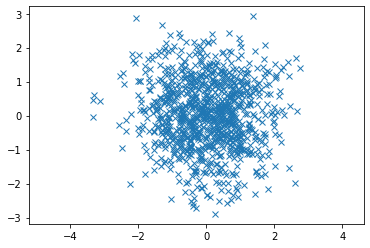

[ 0.05482814  2.05745551  0.50726522  0.70300303 -2.57506715 -0.8646392
  1.25204919  0.10020096  0.56133311 -0.80055398 -0.10267501  1.6836442
 -1.29321002  1.15306296 -1.61104031 -0.66369658 -1.97865489  2.46185845
 -0.19816384 -1.23690338  0.1038903  -1.13381922 -1.24982046 -1.19724747
 -0.22687741 -1.81225595 -0.15689891  1.23920068  0.01967375 -1.66406901
 -1.05027672 -1.17712495  1.90402979 -0.81972326 -0.77868161 -0.49410422
  0.8957692  -0.21019664  2.66822008  0.42838718  0.20896905  0.25057006
 -0.80767229 -0.77098319  0.51151365  0.96010085 -1.23179164 -1.95863216
 -0.48786416 -1.0630402   0.5244525  -0.25911496 -0.21401727 -1.01370324
 -1.10485283  0.16961835  1.03347395 -0.81911284 -0.01182572 -0.64220816
  0.34702823 -1.55134823  1.00740747  0.64666241  0.06142089  0.6706333
  1.00708453 -0.61862169 -0.79287619  2.1883856  -0.18715243  0.28235552
 -1.70346067 -1.12820024  0.75751872 -0.17280131 -0.89024989 -0.5818943
  0.76451988 -0.01607611 -0.72872849 -0.30007335 -1.220

In [ ]:
#2a get data
import matplotlib.pyplot as plt
mean = [0, 0]
cov = [[1, 0], [0, 1]]
x, y = np.random.multivariate_normal(mean, cov, 1000).T
plt.plot(x, y, 'x')
plt.axis('equal')
plt.show()
print(x)

[[ 0.05482814  1.19666395]
 [ 2.05745551  1.20318778]
 [ 0.50726522 -0.05514024]
 ...
 [ 0.72693327  0.6231255 ]
 [ 0.99416045  1.02730096]
 [ 2.39584292  1.5810891 ]]


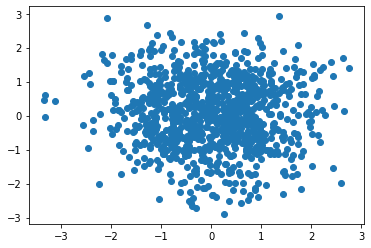

In [ ]:
#2a preprecessing 2
init_centers=np.array([[0,0],[2,0],[-2,0]])
X = np.array([x, y]).transpose()
plt.scatter(X[:,0], X[:,1])
print(X)

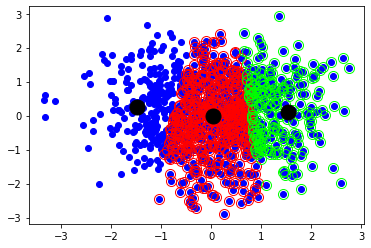

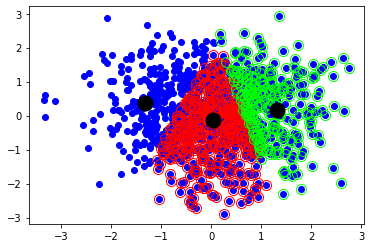

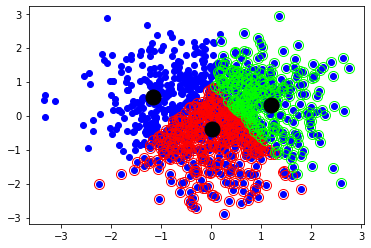

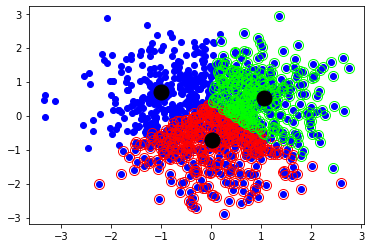

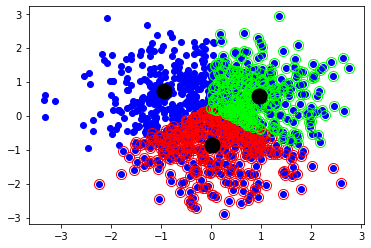

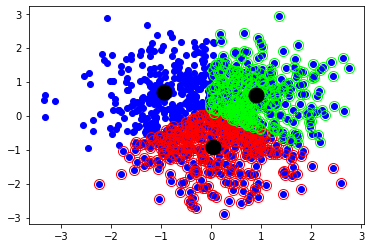

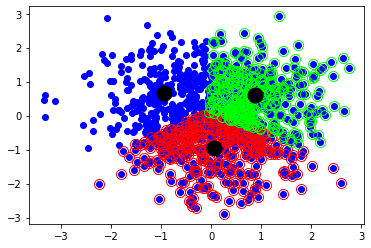

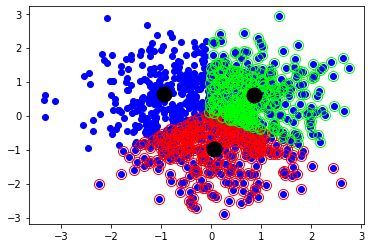

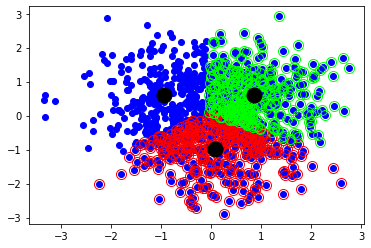

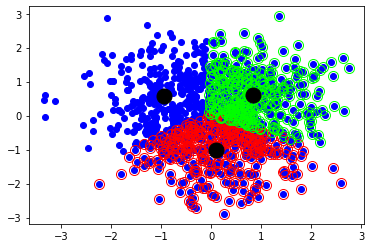

In [ ]:
#2b run k-means
for i in range(10):
    kmeans=KMeans(n_clusters=3,init=init_centers,n_init=1,max_iter=1)
    kmeans.fit(X)
    show_clusters(kmeans,X)
    init_centers=kmeans.cluster_centers_


In [ ]:
#2c
print(init_centers)
print(X[0])
m_X = np.copy(X)
#print(kmeans.predict(m_X))
labels = kmeans.predict(m_X)
for i, pair in enumerate(m_X):
  new_x = pair[0]*0.99 + init_centers[labels[i]][0]*0.01
  new_y = pair[1]*0.99 + init_centers[labels[i]][1]*0.01
  m_X[i][0], m_X[i][1] = new_x, new_y
print(m_X[0])


[[ 0.10178348 -1.00113149]
 [ 0.8444216   0.61526934]
 [-0.95179595  0.5893694 ]]
[0.05482814 1.19666395]
[0.06272407 1.19085001]


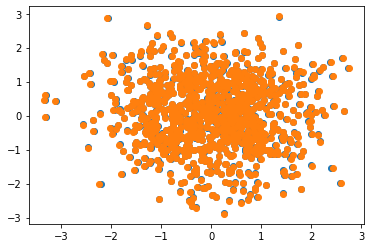

In [ ]:
#plot
plt.scatter(m_X[:,0], m_X[:,1])
plt.scatter(X[:,0], X[:,1])


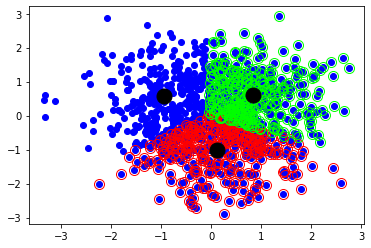

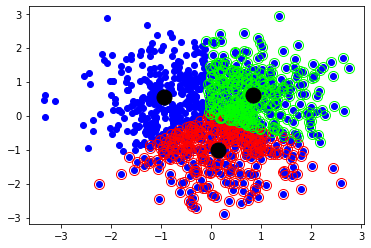

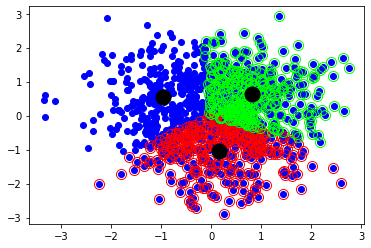

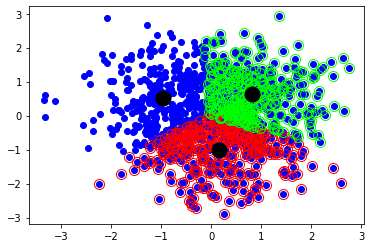

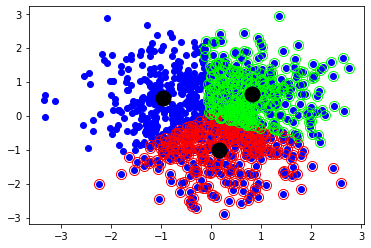

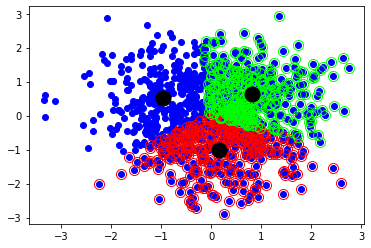

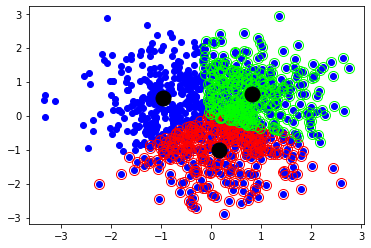

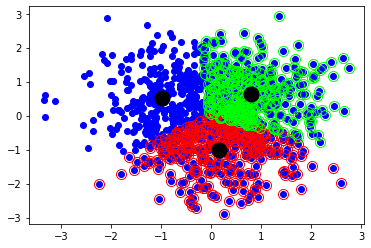

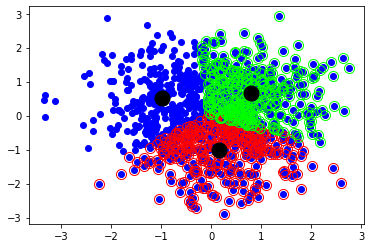

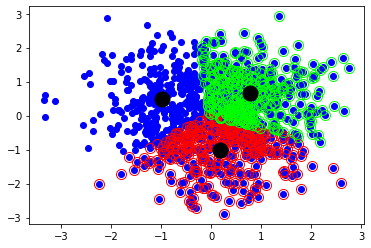

In [ ]:
#2c run k-means
for i in range(10):
    kmeans=KMeans(n_clusters=3,init=init_centers,n_init=1,max_iter=1)
    kmeans.fit(X)
    show_clusters(kmeans,X)
    init_centers=kmeans.cluster_centers_

4d

In [ ]:
def modify(original_X):
  labels = kmeans.predict(original_X)
  for i, pair in enumerate(original_X):
    new_x = pair[0]*0.99 + init_centers[labels[i]][0]*0.01
    new_y = pair[1]*0.99 + init_centers[labels[i]][1]*0.01
    original_X[i][0], original_X[i][1] = new_x, new_y
  return original_X

def loop(X, time):
  init_centers=np.array([[0,0],[2,0],[-2,0]])
  for i in range(time):
    for _ in range(10):
      kmeans=KMeans(n_clusters=3,init=init_centers,n_init=1,max_iter=1)
      kmeans.fit(X)
      show_clusters(kmeans,X)
      init_centers=kmeans.cluster_centers_
    X = modify(X)
  return X



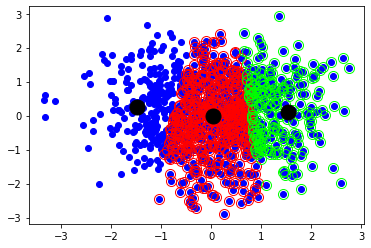

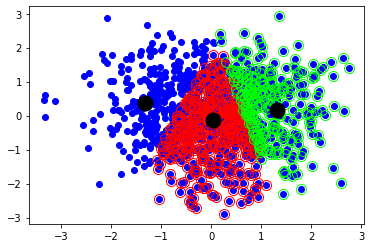

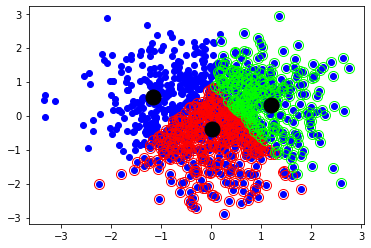

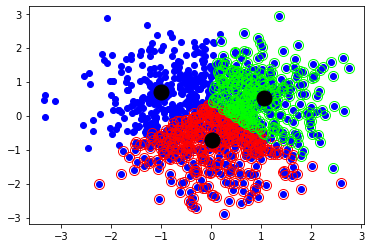

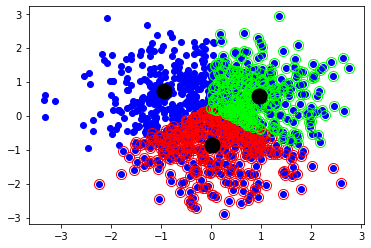

...

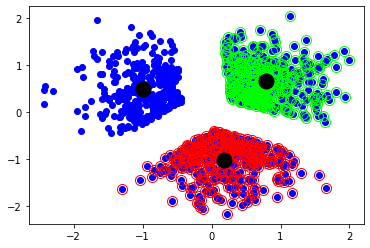

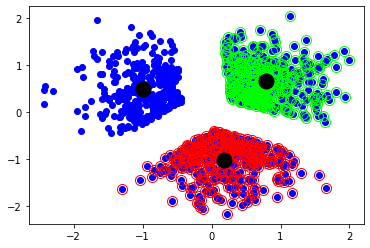

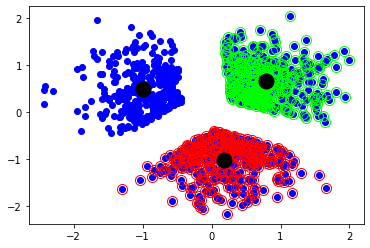

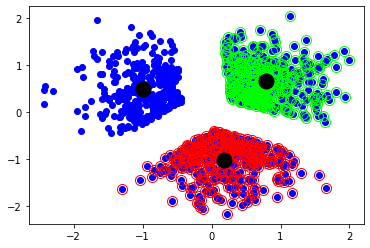

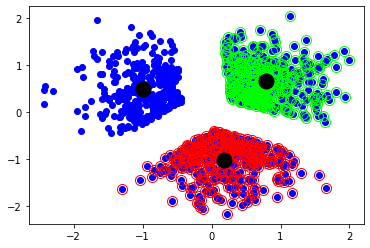

In [ ]:
final_X = loop(X, 50)

problem 5

In [ ]:
import json
from google.colab import drive
from pprint import pprint

drive.mount('/content/drive', force_remount=True)
speeches=[]
with open("/content/drive/MyDrive/ml_large/speeches.json") as f:
  for line in f:
    speeches.append(json.loads(line))
    #pprint(line)


Mounted at /content/drive


In [ ]:
print(speeches[0])

{'president': 'James Monroe', 'text': ' Fellow-Citizens of the Senate and House of Representatives:\r\n\r\n \r\n\r\nThe progress of our affairs since the last session has been such as may justly be claimed and expected under a Government deriving all its powers from an enlightened people, and under laws formed by their representatives, on great consideration, for the sole purpose of promoting the welfare and happiness of their constituents. In the execution of those laws and of the powers vested by the Constitution in the Executive, unremitted attention has been paid to the great objects to which they extend.\r\n\r\nIn the concerns which are exclusively internal there is good cause to be satisfied with the result. The laws have had their due operation and effect.\r\n\r\nIn those relating to foreign powers, I am happy to state that peace and amity are preserved with all by a strict observance on both sides of the rights of each.\r\n\r\nIn matters touching our commercial intercourse, whe

In [ ]:
#5a
import nltk
from nltk import tokenize

In [ ]:
#5a continue
import sys
import numpy as np
nltk.download('punkt')
sentenses = []
l_president = 'nb'
l_length = 0
s_president = 'nb'
s_length = sys.maxsize


for sp in speeches:
  new_lst = tokenize.sent_tokenize(sp['text'])
  len_lst = []
  for s in new_lst:
    if len(s) > l_length:
      l_president = sp['president']
      l_length = len(s)
    elif len(s) < s_length:
      s_president = sp['president']
      s_length = len(s)
    len_lst.append(len(s))
  print(f"for president {sp['president']}, Q1 quantile of arr is {np.quantile(len_lst, .25)}; Q2 quantile of arr is {np.quantile(len_lst, .50)}, Q2 quantile of arr is {np.quantile(len_lst, .75)}")
  sentenses.extend(new_lst)
# print(sentenses[0], sentenses[1])
# print(speeches[0])

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


for president James Monroe, Q1 quantile of arr is 135.0; Q2 quantile of arr is 190.0, Q2 quantile of arr is 280.5
for president William McKinley, Q1 quantile of arr is 110.0; Q2 quantile of arr is 170.0, Q2 quantile of arr is 245.75
for president Dwight D. Eisenhower, Q1 quantile of arr is 89.0; Q2 quantile of arr is 126.0, Q2 quantile of arr is 176.0
for president Calvin Coolidge, Q1 quantile of arr is 61.0; Q2 quantile of arr is 93.0, Q2 quantile of arr is 138.0
for president James Madison, Q1 quantile of arr is 153.0; Q2 quantile of arr is 230.0, Q2 quantile of arr is 334.0
for president Grover Cleveland, Q1 quantile of arr is 134.0; Q2 quantile of arr is 203.0, Q2 quantile of arr is 285.0
for president John Quincy Adams, Q1 quantile of arr is 138.0; Q2 quantile of arr is 215.0, Q2 quantile of arr is 313.0
for president Theodore Roosevelt, Q1 quantile of arr is 109.0; Q2 quantile of arr is 160.0, Q2 quantile of arr is 232.0
for president Lyndon B. Johnson, Q1 quantile of arr is 61.0

In [ ]:
#5b
print(f"the most wordy president is {l_president} with a sentense of {l_length} letters! His opposite is {s_president} with a sentense of {s_length} letters!")

the most wordy president is Chester A. Arthur with a sentense of 7007 letters! His opposite is Barack Obama with a sentense of 1 letters!


In [ ]:
#5c

class Year:
    def __init__(self):
        self.num_of_sentense = 0
        self.num_of_word = 0

    def mean_sentense_length(self):
        return self.num_of_word/self.num_of_sentense

year_summary = {}
for sp in speeches:
  new_lst = tokenize.sent_tokenize(sp['text'])
  sentense = len(new_lst)
  word = 0
  for s in new_lst:
    word += len(s.split())
  if sp['year'] not in year_summary:
    year_summary[sp['year']] = Year()
  year_summary[sp['year']].num_of_sentense += sentense
  year_summary[sp['year']].num_of_word += word

In [ ]:
yrs = []
mns = []
sens = []
words_tot = []
for yr, info in year_summary.items():
  yrs.append(yr)
  mns.append(info.mean_sentense_length())
  sens.append(info.num_of_sentense)
  words_tot.append(info.num_of_word)


In [ ]:
def coefficient(x, y):
    n = np.size(x)
    m_x = np.mean(x)
    m_y = np.mean(y)

    # calculating regression coefficients
    b_1 = (np.sum(y*x) - n*m_y*m_x) / (np.sum(x*x) - n*m_x*m_x)
    b_0 = m_y - b_1*m_x

    return b_0, b_1

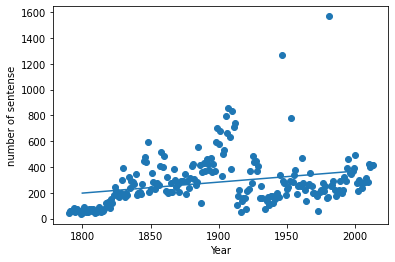

In [ ]:
#linear regression of # of sentense
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker

res = [eval(i) for i in yrs]
a0, a1 = coefficient(np.array(res), np.array(sens))
x0 = np.linspace(1800, 2000, 10)
y0 = a0 + a1*x0
fig, ax = plt.subplots()
myLocator = mticker.MultipleLocator(50)
ax.xaxis.set_major_locator(myLocator)
ax.plot(x0, y0)
ax.scatter(np.array(res), np.array(sens))
ax.set_xlabel('Year')
ax.set_ylabel('number of sentense')
plt.show()


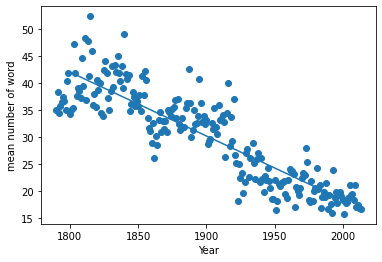

In [ ]:
#linear regression of mean # of word
res = [eval(i) for i in yrs]
a0, a1 = coefficient(np.array(res), np.array(mns))
x0 = np.linspace(1800, 2000, 10)
y0 = a0 + a1*x0
fig, ax = plt.subplots()
myLocator = mticker.MultipleLocator(50)
ax.xaxis.set_major_locator(myLocator)
ax.plot(x0, y0)
ax.scatter(np.array(res), np.array(mns))
ax.set_xlabel('Year')
ax.set_ylabel('mean number of word')
plt.show()

In [ ]:
#5d



5d (i)


Comparing to single linear regression, we'll need more than one parameter/independent value to do the comparison.


5d (ii)

advantage: instead of a straigt line, one can fit a curve using multiple independent parameters. Also the outcoming prediction (model) will react better when facing changes

In [ ]:
print(len(res))

223


In [ ]:
#5d implementation
from numpy.linalg import inv
res_reserved, sens_reserved, mns_reserved = np.array(res[210:]), np.array(sens[210:]), np.array(mns[210:]) #for prediction
sample = np.transpose([res_reserved, sens_reserved, mns_reserved])
y = my_array = np.array(words_tot[:210]).reshape(-1, 1)
X = np.transpose([np.array(res[:210]), np.array(sens[:210]), np.array(mns[:210])])
XT = X.transpose()
# generate X-matrix for this choice of d
w = np.matmul(np.matmul(inv(np.matmul(XT, X)), XT), y)


In [ ]:
print(w, sample)
predicted = np.matmul(sample, w)
print(predicted)

[[ -3.47180321]
 [ 29.71367795]
 [211.34447787]] [[1823.          184.           34.54891304]
 [1881.          425.           31.34352941]
 [1872.          288.           35.07986111]
 [1915.          223.           34.46188341]
 [1917.          138.           28.34782609]
 [1951.          242.           16.51239669]
 [1976.          274.           18.0729927 ]
 [1855.          275.           42.22545455]
 [1831.          166.           43.26506024]
 [2000.          495.           18.41414141]
 [1842.          206.           40.79126214]
 [1840.          183.           49.06557377]
 [1888.          364.           36.32692308]]
[[ 6439.94147264]
 [12722.1331412 ]
 [ 9472.25856369]
 [ 7260.97578406]
 [ 3436.19730004]
 [ 3907.02585177]
 [ 5100.89181388]
 [10655.18311847]
 [ 7719.4304224 ]
 [11656.3912595 ]
 [ 8346.96413602]
 [ 9419.22322184]
 [11938.5088962 ]]


In [ ]:
print(sample[:,0])
indices = np.argsort(sample[:,0])
x_sorted = np.array(sample[:,0])[indices]
y_sorted = np.array(predicted)[indices]
print(x_sorted)

[1926. 1858. 1876. 1799. 1934. 1898. 1815. 2005. 1996. 1807. 1823. 1881.
 1872. 1915. 1917. 1951. 1976. 1855. 1831. 2000. 1842. 1840. 1888.]
[1799. 1807. 1815. 1823. 1831. 1840. 1842. 1855. 1858. 1872. 1876. 1881.
 1888. 1898. 1915. 1917. 1926. 1934. 1951. 1976. 1996. 2000. 2005.]


AttributeError: ignored

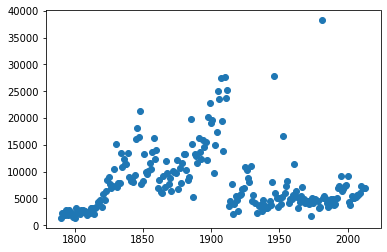

In [ ]:
plt.scatter(np.array(res), np.array(words_tot))
plt.scatter(sample[:,0], predicted)
